<a href="https://colab.research.google.com/github/Mahmoudshakra/adaptive_threshold/blob/main/adaptive_threshold.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [76]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d
from scipy.signal import find_peaks
def adaptive_threshold(fft_data, window_size):
  mean = np.mean(fft_data)
  std = np.std(fft_data)
  median = np.median(fft_data)
  threshold = mean + 1 * std  # k is a tunable parameter
  #threshold = median
  return threshold

In [57]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [58]:
def read_floats_from_file(file_path):
    try:
        # Open the file in read mode
        with open(file_path, 'r') as file:
            # Read the entire content of the file
            file_contents = file.read()

        # Split the content by comma
        string_elements = file_contents.split(',')

        # Convert each element to a float, handling errors
        float_array = []
        for element in string_elements:
            try:
                # Strip any surrounding whitespace and convert to float
                num = float(element.strip())
                float_array.append(num)
            except ValueError:
                print(f"Warning: '{element.strip()}' is not a valid float and will be skipped.")

        return float_array

    except FileNotFoundError:
        print(f"Error: The file {file_path} was not found.")
        return []
# Example usage
file_path1 = '/content/drive/MyDrive/100_cf_25M_fs_2048_fft_2.txt'
fftt_stream1 = read_floats_from_file(file_path1)
print(fftt_stream1)

In [59]:
def read_floats_from_file(file_path):
    try:
        # Open the file in read mode
        with open(file_path, 'r') as file:
            # Read the entire content of the file
            file_contents = file.read()

        # Split the content by comma
        string_elements = file_contents.split(',')

        # Convert each element to a float, handling errors
        float_array = []
        for element in string_elements:
            try:
                # Strip any surrounding whitespace and convert to float
                num = float(element.strip())
                float_array.append(num)
            except ValueError:
                print(f"Warning: '{element.strip()}' is not a valid float and will be skipped.")

        return float_array

    except FileNotFoundError:
        print(f"Error: The file {file_path} was not found.")
        return []
# Example usage
file_path2 = '/content/drive/MyDrive/110_cf_25M_fs_2048_fft_2.txt'
fftt_stream2 = read_floats_from_file(file_path2)
print(fftt_stream2)

[-106.18804931640625, -103.6093978881836, -107.5157470703125, -119.85658264160156, -107.01918029785156, -100.74002838134766, -100.04763793945312, -104.5050277709961, -111.49198150634766, -110.26776123046875, -108.37063598632812, -111.52731323242188, -105.34426879882812, -102.93758392333984, -104.04035949707031, -100.10377502441406, -97.33792877197266, -98.82483673095703, -104.720458984375, -118.1434097290039, -109.71388244628906, -100.73541259765625, -101.119140625, -104.03225708007812, -100.56805419921875, -100.53983306884766, -104.17898559570312, -118.64563751220703, -104.00685119628906, -102.47747039794922, -103.29747009277344, -108.01338958740234, -110.86030578613281, -107.42377471923828, -106.9778823852539, -101.22979736328125, -101.20490264892578, -106.47798156738281, -112.29349517822266, -98.84284210205078, -95.79763793945312, -97.6761245727539, -105.22205352783203, -125.93343353271484, -114.50487518310547, -127.3353500366211, -109.20838165283203, -109.92682647705078, -105.50191

In [60]:
def read_floats_from_file(file_path):
    try:
        # Open the file in read mode
        with open(file_path, 'r') as file:
            # Read the entire content of the file
            file_contents = file.read()

        # Split the content by comma
        string_elements = file_contents.split(',')

        # Convert each element to a float, handling errors
        float_array = []
        for element in string_elements:
            try:
                # Strip any surrounding whitespace and convert to float
                num = float(element.strip())
                float_array.append(num)
            except ValueError:
                print(f"Warning: '{element.strip()}' is not a valid float and will be skipped.")

        return float_array

    except FileNotFoundError:
        print(f"Error: The file {file_path} was not found.")
        return []
# Example usage
file_path3 = '/content/drive/MyDrive/150_cf_25M_fs_2048_fft_2.txt'
fftt_stream3 = read_floats_from_file(file_path3)
print(fftt_stream3)

In [61]:
def read_floats_from_file(file_path):
    try:
        # Open the file in read mode
        with open(file_path, 'r') as file:
            # Read the entire content of the file
            file_contents = file.read()

        # Split the content by comma
        string_elements = file_contents.split(',')

        # Convert each element to a float, handling errors
        float_array = []
        for element in string_elements:
            try:
                # Strip any surrounding whitespace and convert to float
                num = float(element.strip())
                float_array.append(num)
            except ValueError:
                print(f"Warning: '{element.strip()}' is not a valid float and will be skipped.")

        return float_array

    except FileNotFoundError:
        print(f"Error: The file {file_path} was not found.")
        return []
# Example usage
file_path4 = '/content/drive/MyDrive/390_cf_25M_fs_2048_fft_2.txt'
fftt_stream4 = read_floats_from_file(file_path4)
print(fftt_stream4)

In [77]:
# inputs
window_size = 100
threshold_values = []
fft_stream = np.concatenate((fftt_stream1[0:2047], fftt_stream2[0:2047], fftt_stream3[0:2047],fftt_stream4[0:2047]))
#fft_stream = np.concatenate ((fftt_stream1[0:2047], fftt_stream2[0:2047]))
#fft_stream = fftt_stream4[0:2047]
SNR=7

In [78]:
# threshold
for i in range(len(fft_stream) - window_size):
  data_window = fft_stream[i:i+window_size]
  threshold = adaptive_threshold(data_window, window_size)+SNR
  threshold_values.append(threshold)
# Apply Gaussian filter
sigma = 60
threshold_values_smooth = gaussian_filter1d(threshold_values, sigma)
fft_stream=fft_stream[0:len(threshold_values_smooth)]

In [79]:
# Peaks Above the Threshold
peaks, _ = find_peaks(fft_stream)
filtered_peaks = [peak for peak in peaks if fft_stream[peak] > threshold_values_smooth[peak]]
x = np.linspace(0, 1, len(threshold_values_smooth))

<function matplotlib.pyplot.show(close=None, block=None)>

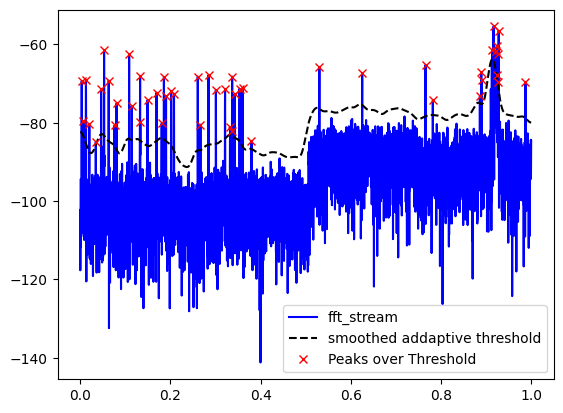

In [80]:
#plt.plot(threshold_values[0:8500], label='addaptive threshold',color='red')
plt.plot(x,fft_stream, label='fft_stream',color='blue')
plt.plot(x,threshold_values_smooth, linestyle='--', label='smoothed addaptive threshold',color='black')
plt.plot(x[filtered_peaks], fft_stream[filtered_peaks], "x", label="Peaks over Threshold",color='red')
plt.legend()
plt.show